# sklearn.DecisionTreeClassifier
This notebook demonstrates a simple sklearn.DecisionTreeClassifier

In [1]:
# magic to help out Jupyter notebooks
import os, sys
sys.path.append(os.path.abspath('..\src'))

In [2]:
import pandas as pd 

# allow log messages in notebooks
import logging
logging.basicConfig(stream=sys.stdout, level=logging.INFO)

# use the pecarn module to bring the PECARN dataset into the notebook
from data import pecarn

# cleaned PECARN data
pecarn_cleaned = pecarn.clean(pecarn.load(fromCsv=False))

# processed data, ready for splitting into training and test sets
X = pecarn_cleaned.drop(columns='PosIntFinal')
y = pecarn.preprocess(pecarn_cleaned[['PosIntFinal']])

INFO:data.pecarn.load:Loading from Pickle file c:\Jan\Capstone\notebooks\PECARN_TBI.pkl


In [4]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.75, test_size=0.25, stratify=y, random_state=1234)

In [5]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.pipeline import Pipeline 

clf = DecisionTreeClassifier()
pipeline = Pipeline(steps=[
    ('data.pecarn.preprocess', pecarn.make_preprocess_pipeline()),
    ('decisiontree', clf)
])

In [6]:
pipeline.fit(X_train, y_train)

[Pipeline] .. (step 1 of 1) Processing convert_to_float, total=   0.6s


Pipeline(steps=[('data.pecarn.preprocess',
                 Pipeline(steps=[('convert_to_float',
                                  FunctionTransformer(func=<function _convert_to_float at 0x000002E3390D7B88>))],
                          verbose=True)),
                ('decisiontree', DecisionTreeClassifier())])

In [7]:
pipeline.score(X_test, y_test)

0.9765769088897086

In [8]:
from sklearn.metrics import f1_score
y_pred = pipeline.predict(X_test)
f1_score(y_test, y_pred)

0.3804878048780488

In [19]:
import shap

explainer = shap.TreeExplainer(pipeline.named_steps.decisiontree)

In [36]:
shap_values = explainer.shap_values(X_train)

In [41]:
len(shap_values)

2

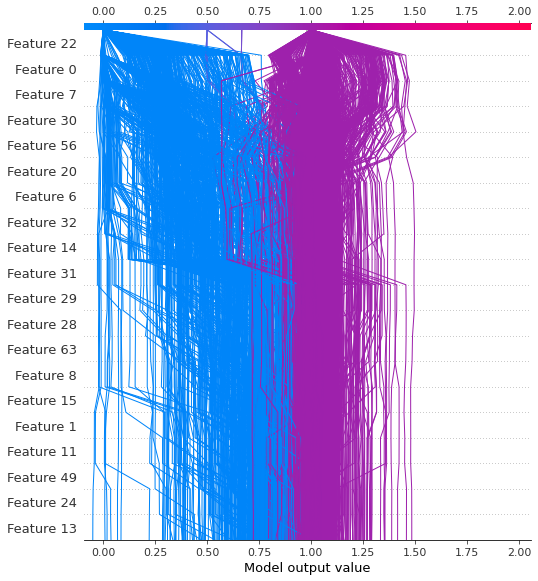

In [45]:
# visualize the first prediction's explanation (use matplotlib=True to avoid Javascript)
shap.decision_plot(explainer.expected_value[0], shap_values[0], ignore_warnings=True)